In [1]:
import numpy as np
from numpy.linalg import norm
from umap import UMAP
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
from tqdm import tqdm

from utils import encode_image
from utils import bt_embeddings

from PIL import Image
from IPython.display import display

In [2]:
img1 = {
  'caption': 'Black Audi car on the road',
  'image_path' : './data/images/car_1.jpg'
}

img2 = {
    'caption': 'Blue Audi car',
    'image_path' : './data/images/car_2.jpg'
}

img3 = {
    'caption': 'Harley Davidson motorcycle on the road',
    'image_path' : './data/images/motorcycle_3.jpg'
}

img4 = {
    'caption': 'A motorcycle sits parked across from a herd of livestock',
    'image_path' : './data/images/motorcycle_1.jpg'
}

img5 = {
    'caption': 'Motorcycle on platform to be worked on in garage',
    'image_path' : './data/images/motorcycle_2.jpg'
}

img6 = {
    'caption': 'Cat lying on the ground',
    'image_path' : './data/images/cat_1.jpg'
}

img7 = {
    'caption': 'Cat playing on the grass',
    'image_path' : './data/images/cat_2.jpg'
}

img8 = {
    'caption': 'Black cat in the garden',
    'image_path' : './data/images/cat_3.jpg'
}

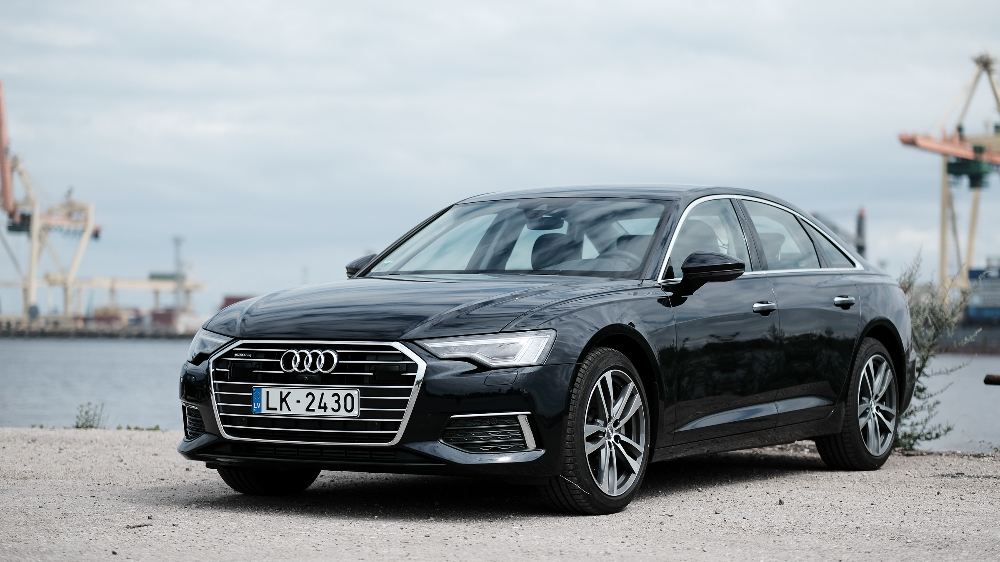

'Black Audi car on the road'

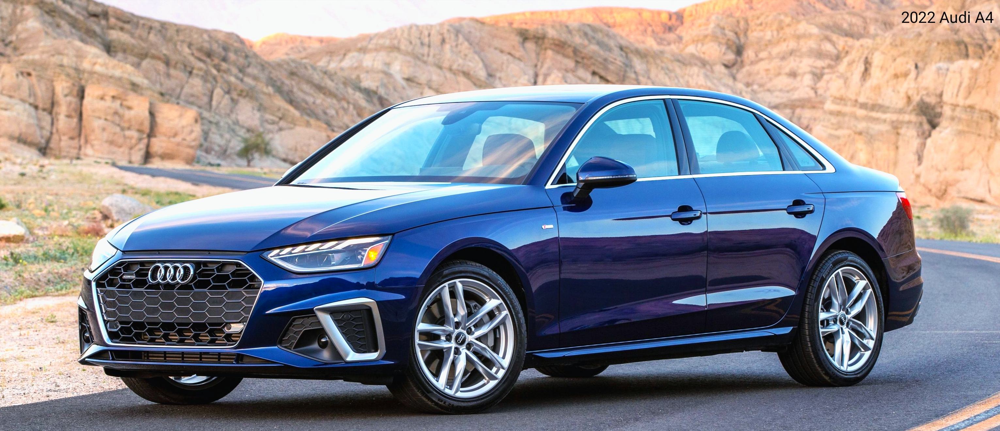

'Blue Audi car'

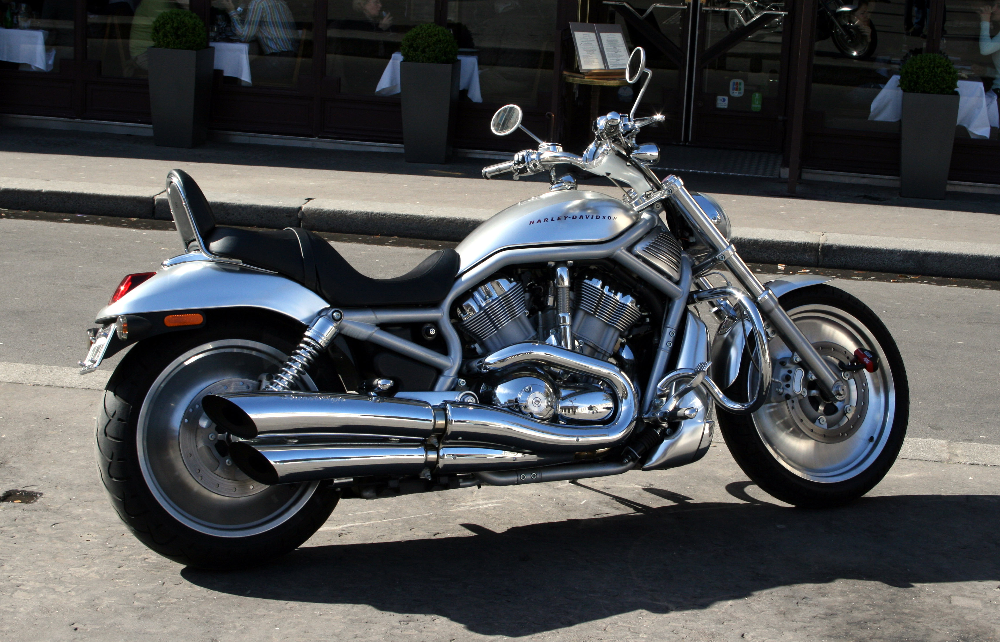

'Harley Davidson motorcycle on the road'

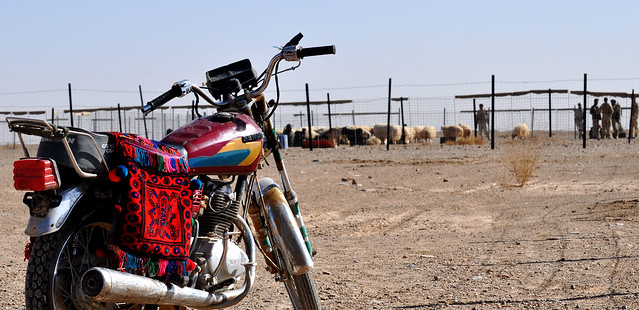

'A motorcycle sits parked across from a herd of livestock'

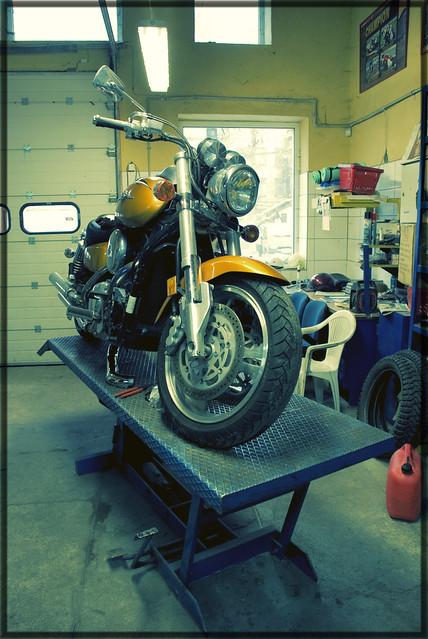

'Motorcycle on platform to be worked on in garage'

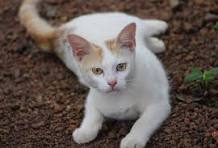

'Cat lying on the ground'

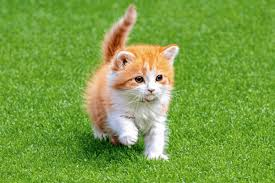

'Cat playing on the grass'

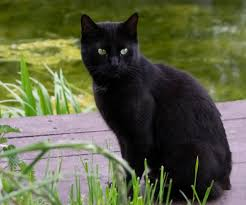

'Black cat in the garden'

In [3]:
image_text_pairs = [img1, img2, img3, img4, img5, img6, img7, img8]

for img in image_text_pairs:
    image = Image.open(img['image_path'])
    caption = img['caption']
    display(image)
    display(caption)

In [4]:
embeddings = []

for img in image_text_pairs:
    img_path = img['image_path']
    caption = img['caption']
    base64_img = encode_image(img_path)
    embedding = bt_embeddings(caption, base64_img)
    embeddings.append(embedding)

preprocessor_config.json:   0%|          | 0.00/99.0 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/3.68G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/3.68G [00:00<?, ?B/s]

Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/

In [5]:
embeddings = []

for img in image_text_pairs:
    img_path = img['image_path']
    caption = img['caption']
    base64_img = encode_image(img_path)
    embedding = bt_embeddings(caption, base64_img)
    embeddings.append(embedding)

Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/

In [5]:
# Each image-text pair is now converted into multimodal 
# embedding vector which has dimensions of 512.

print(len(embeddings[0]))

512


In [6]:
embeddings[0][:12]

[0.06960741430521011,
 0.02518639899790287,
 -0.0011375058675184846,
 -0.00895295012742281,
 0.03307067230343819,
 -0.0013682834105566144,
 0.01627853326499462,
 0.008079764433205128,
 0.08839815109968185,
 -0.04353442043066025,
 0.0016392883844673634,
 0.06008677929639816]

In [7]:
def cosine_similarity(vec1, vec2):
    similarity = np.dot(vec1,vec2)/(norm(vec1)*norm(vec2))
    return similarity

In [8]:
ex1_embed = np.array(embeddings[0])
ex2_embed = np.array(embeddings[1])
ex3_embed = np.array(embeddings[6])
sim_ex1_ex2 = cosine_similarity(ex1_embed, ex2_embed)
sim_ex1_ex3 = cosine_similarity(ex1_embed, ex3_embed)

In [9]:
print("Cosine similarity between ex1_embeded and ex2_embeded is:")
display(sim_ex1_ex2)
print("Cosine similarity between ex1_embeded and ex3_embeded is:")
display(sim_ex1_ex3)

Cosine similarity between ex1_embeded and ex2_embeded is:


np.float64(0.6728666324086628)

Cosine similarity between ex1_embeded and ex3_embeded is:


np.float64(0.0978277268392553)

'Black Audi car on the road'

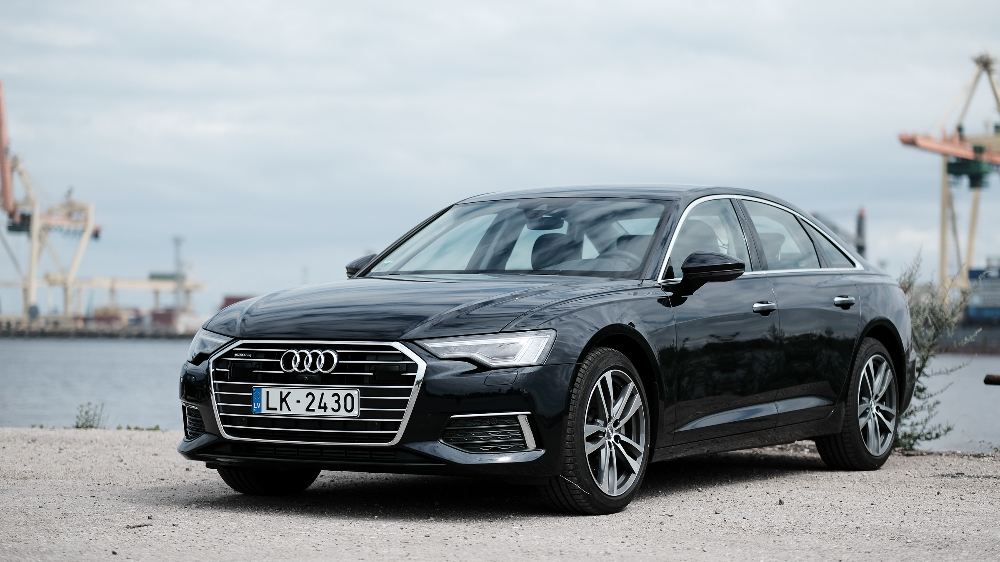

In [10]:
for img in image_text_pairs:
    img['pil_img'] = Image.open(img['image_path'])
# display an example of a cat image-text pair data
display(image_text_pairs[0]['caption'])
display(image_text_pairs[0]['pil_img'])

In [11]:
image_text_pairs[0]

{'caption': 'Black Audi car on the road',
 'image_path': './data/images/car_1.jpg',
 'pil_img': <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2400x1350>}

In [12]:
len(embeddings)

8

In [16]:
# compute BridgeTower embeddings for cat image-text pairs
embeddings = []
for img_txt_pair in tqdm(
                        image_text_pairs, 
                        total=len(image_text_pairs)
                    ):
    pil_img = img_txt_pair['pil_img']
    caption = img_txt_pair['caption']
    base64_img = encode_image(pil_img)
    embedding = bt_embeddings(caption, base64_img)
    embeddings.append(embedding)

  0%|          | 0/8 [00:00<?, ?it/s]Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
 12%|█▎        | 1/8 [00:07<00:52,  7.47s/it]Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
 25%|██▌       | 2/8 [00:14<00:44,  7.46s/it]Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions 

In [13]:
# function transforms high-dimension vectors to 2D vectors using UMAP
def dimensionality_reduction(embed_arr, label):
    X_scaled = MinMaxScaler().fit_transform(embed_arr)
    print(X_scaled)
    mapper = UMAP(n_components=2, metric="cosine").fit(X_scaled)
    df_emb = pd.DataFrame(mapper.embedding_, columns=["X", "Y"])
    df_emb["label"] = label
    print(df_emb)
    return df_emb

In [14]:
# prepare labels for the 3 examples
labels = ['car'] * 2 + ['motorcycle'] * 3 + ['cat'] * 3
print(labels)
# compute dimensionality reduction for the 3 examples
reduced_dim_emb = dimensionality_reduction(embeddings, labels)

['car', 'car', 'motorcycle', 'motorcycle', 'motorcycle', 'cat', 'cat', 'cat']
[[0.87979891 0.51975621 0.46370655 ... 0.89495575 0.61318386 0.21745817]
 [1.         1.         0.42415038 ... 0.67248683 0.89007335 0.30896024]
 [0.60595441 0.04962012 0.52268614 ... 1.         1.         0.23729948]
 ...
 [0.         0.40198273 1.         ... 0.45749212 0.         1.        ]
 [0.09835006 0.83714253 0.49136366 ... 0.32038793 0.03792694 0.52285185]
 [0.05216952 0.63923583 0.95375209 ... 0.45618086 0.08228366 0.7891762 ]]


/Users/ron/Documents/github/Multimodal-RAG-BTM/multimodal/lib/python3.13/site-packages/umap/umap_.py:2462: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(


           X          Y       label
0  10.002914  17.793741         car
1   9.318230  17.610312         car
2   8.583013  18.190985  motorcycle
3   8.278978  17.271976  motorcycle
4   7.765250  17.901638  motorcycle
5   9.491988  15.994731         cat
6   9.888735  16.614986         cat
7   8.941195  16.504988         cat


In [16]:
!pip install seaborn

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


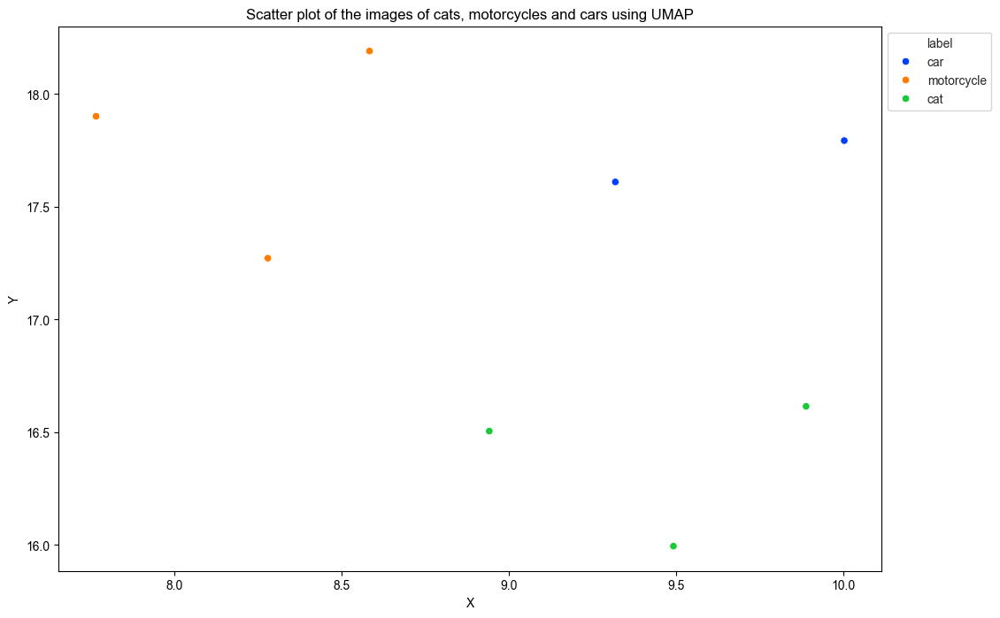

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the centroids against the cluster
fig, ax = plt.subplots(figsize=(12,8)) # Set figsize

sns.set_style("whitegrid", {'axes.grid' : False})
sns.scatterplot(data=reduced_dim_emb, 
                x=reduced_dim_emb['X'], 
                y=reduced_dim_emb['Y'], 
                hue='label', 
                palette='bright')
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.title('Scatter plot of the images of cats, motorcycles and cars using UMAP')
plt.xlabel('X')
plt.ylabel('Y')
plt.show()

In [18]:
reduced_dim_emb

,X,Y,label
0,10.002914,17.793741,car
1,9.318230,17.610312,car
2,8.583013,18.190985,motorcycle
3,8.278978,17.271976,motorcycle
4,7.765250,17.901638,motorcycle
5,9.491988,15.994731,cat
6,9.888735,16.614986,cat
7,8.941195,16.504988,cat
